In [1]:
import os
# https://developer.nvidia.com/cuda-gpus#compute
# os.environ['TORCH_CUDA_ARCH_LIST'] = '8.9'

In [2]:
# !python -m pip install -r requirements.txt

In [3]:
from optimization.latentmapper import LatentMapperOptimization
from encoder4editing.utils.common import generate_grid
from encoder4editing.utils.e4e_utils import create_personal_grid
from encoder4editing.utils import e4e_utils
import random
import torch
torch.manual_seed(75)
random.seed(1)

In [4]:
%matplotlib inline

Loading e4e over the pSp framework from checkpoint: encoder4editing/pretrained_models/e4e_ffhq_encode.pt
Aligned image has shape: (256, 256)


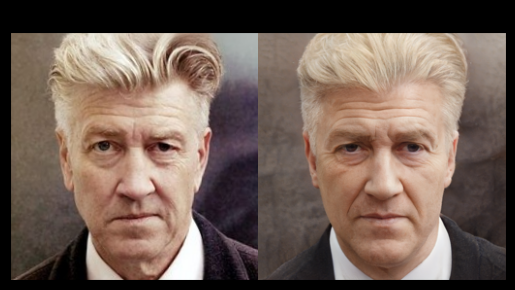

In [5]:
## Load the model

net = e4e_utils.load_model("encoder4editing/pretrained_models/e4e_ffhq_encode.pt")
## Encode Image
sample, latents = e4e_utils.prepare_img("images/david.jpg",net)

# Create mapper
optimizer = LatentMapperOptimization(["Joker"],net.decoder,inf_latents=latents)

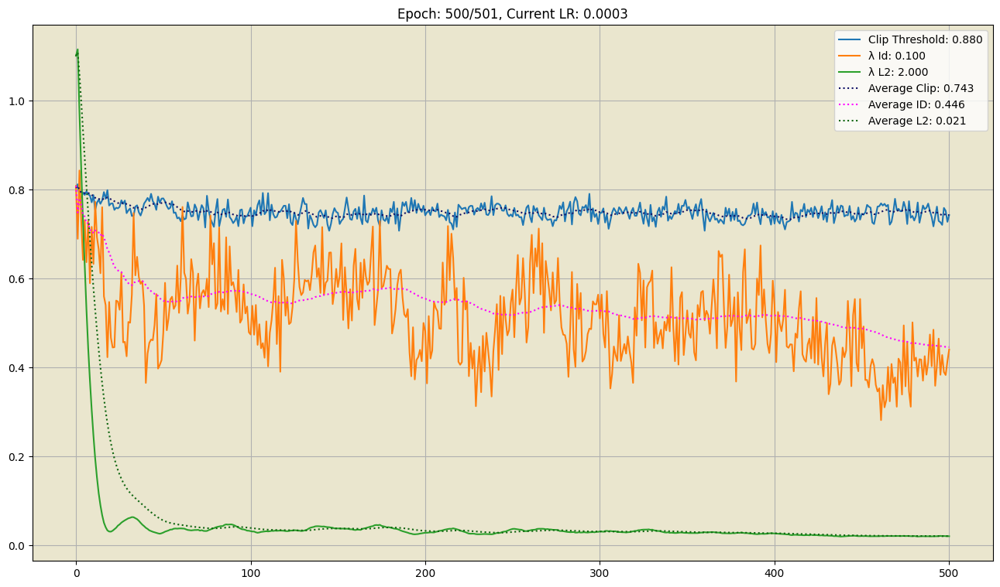

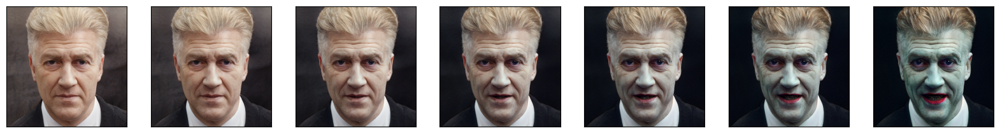

100%|██████████| 501/501 [10:22<00:00,  1.24s/it]


In [ ]:
#fit mapper
optimizer = LatentMapperOptimization(["Joker"],net.decoder,inf_latents=latents)
optimizer.fit(501,lambda_id=0.1,lambda_l2=2,inference_interval=1)

I tried some training methods that adjust the hyperparameters during training.

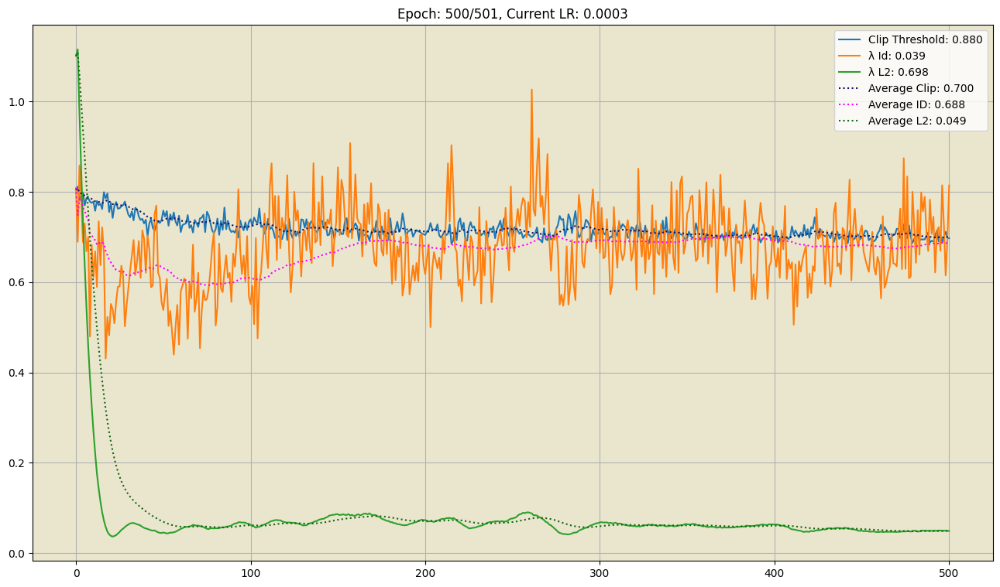

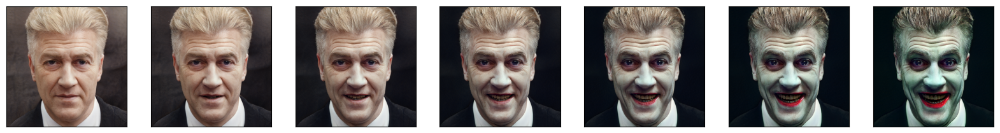

100%|██████████| 501/501 [04:33<00:00,  1.83it/s]


In [ ]:
optimizer = LatentMapperOptimization(["Joker"],net.decoder,inf_latents=latents)
optimizer.fit(501,lambda_id=0.1,lambda_l2=2,inference_interval = 100, l2_threshold =0.5,mode = 'balanced')

## Intensity based scale

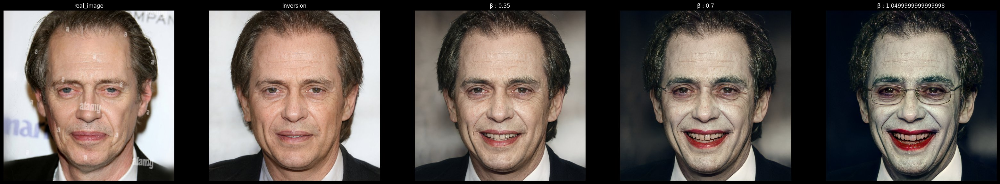

In [16]:
optimizer = LatentMapperOptimization(["Joker"],net.decoder,inf_latents=latents)
optimizer.load_state_dict(torch.load("mappers/joker1024.pt"))
image_path = ("images/steve.jpg")

##Draw series
e4e_utils.series(image_path,optimizer,net,beta_step =0.35)

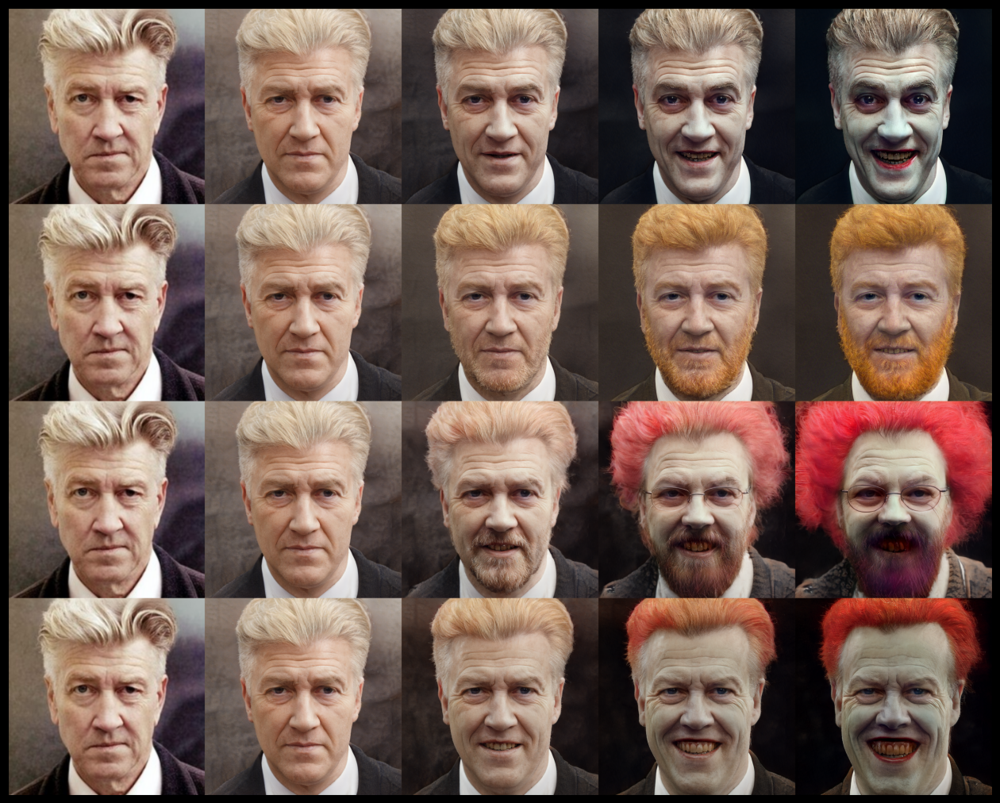

In [6]:
optimizer = LatentMapperOptimization("dummy",net.decoder)


## Concatenate several mappers for one image and create grid
create_personal_grid(image_path="images/david.jpg",
                     mappers=["mappers/joker_balanced.pt",
                      "mappers/ginger_beard.pt",
                      "mappers/penny_beard.pt",
                      "mappers/penny.pt"],
                      optimizer=optimizer,net=net,beta_step=0.35,n_series=4)

## Multiple prompts

Loading e4e over the pSp framework from checkpoint: encoder4editing/pretrained_models/e4e_ffhq_encode.pt


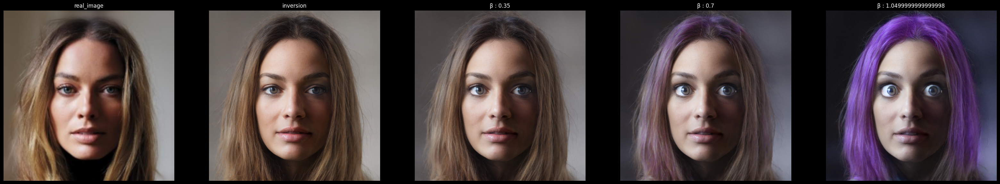

In [7]:
net = e4e_utils.load_model("encoder4editing/pretrained_models/e4e_ffhq_encode.pt")
optimizer = LatentMapperOptimization(["person with purple hair", "surprised person"],net.decoder)


optimizer.load_state_dict(torch.load("mappers/purple_surprised.pt"))
image_path = "images/margot.jpg"
e4e_utils.series(image_path,optimizer,net,beta_step =0.35)

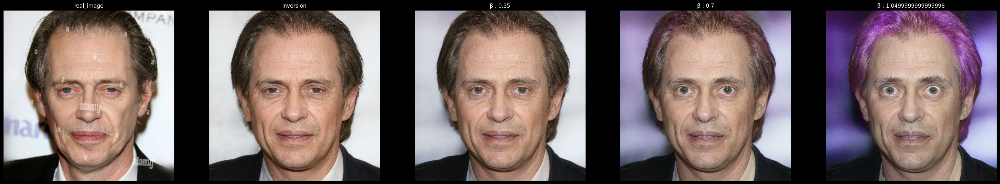

In [8]:
image_path = "images/steve.jpg"
e4e_utils.series(image_path,optimizer,net,beta_step =0.35)

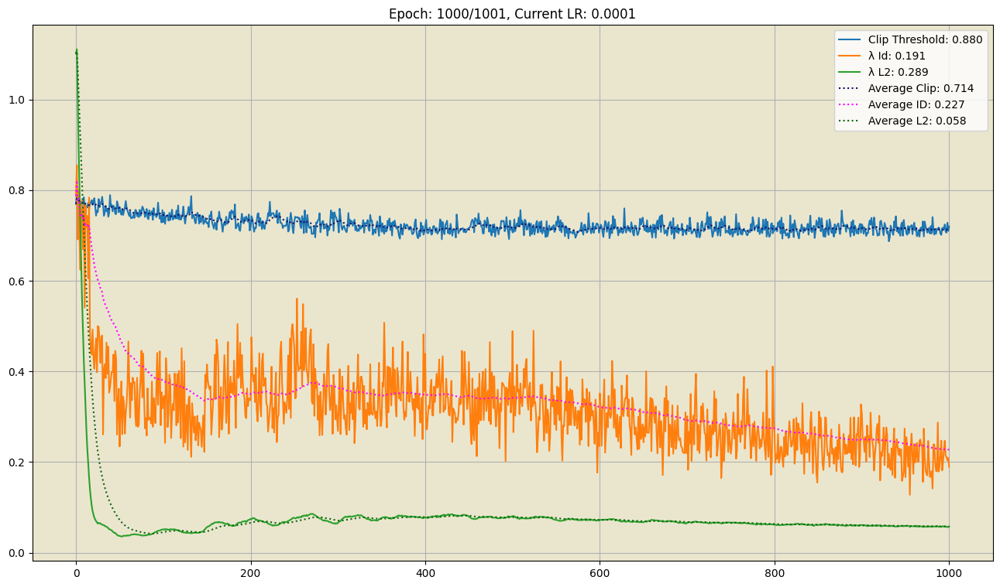

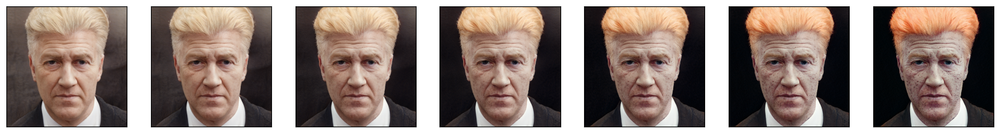

100%|██████████| 1001/1001 [09:20<00:00,  1.79it/s]


In [7]:
optimizer = LatentMapperOptimization(["Ginger","Person with freckles"],net.decoder,inf_latents=latents)
optimizer.fit(epochs = 1001,inference_interval = 100,lambda_id = 0.5,lambda_l2 = 2,id_threshold = 0.2,l2_threshold = 0.3,lr_decay = 0.8,mode = 'balanced')

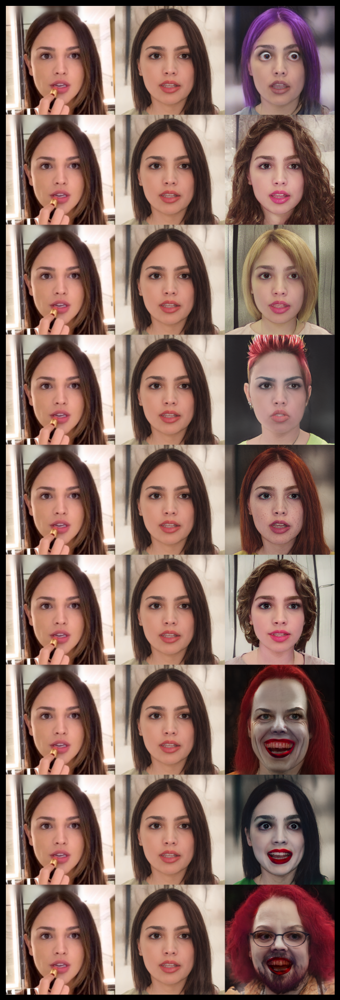

In [ ]:
from encoder4editing.utils.e4e_utils import create_personal_grid
optimizer = LatentMapperOptimization("dummy",net.decoder)

create_personal_grid("images/eiza.jpg",["mappers/purple_surprised.pt","mappers/curly_hair.pt","mappers/straight_short_hair.pt","mappers/angry_mohawk.pt","mappers/ginger_freckles.pt","short_curly_hair.pt","mappers/penny.pt","mappers/joker_simple.pt","mappers/penny_beard.pt"],optimizer,net,1,2)

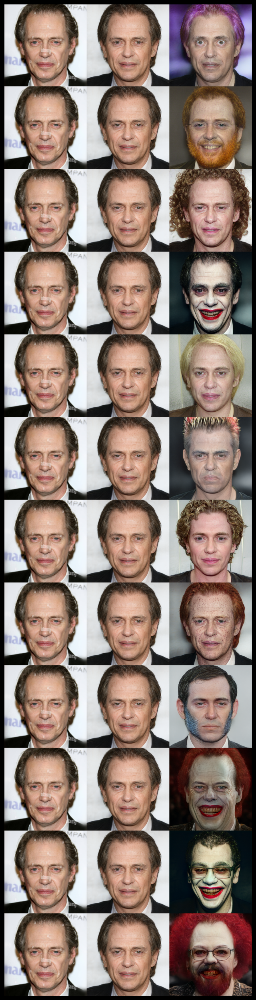

In [ ]:
from encoder4editing.utils.e4e_utils import create_personal_grid
optimizer = LatentMapperOptimization("dummy",net.decoder)

create_personal_grid("images/steve.jpg",["mappers/purple_surprised.pt","mappers/ginger_beard.pt","mappers/curly_hair.pt","mappers/joker_balanced.pt","mappers/straight_short_hair.pt","mappers/angry_mohawk.pt","short_curly_hair.pt","mappers/ginger_freckles.pt","mappers/sideburns.pt","mappers/penny.pt","mappers/joker_experimental.pt","mappers/penny_beard.pt"],optimizer,net,1,2)

By default levels of mapper such as coarse/medium/fine are split evenly which can be changed by the levels parameter of the mapper

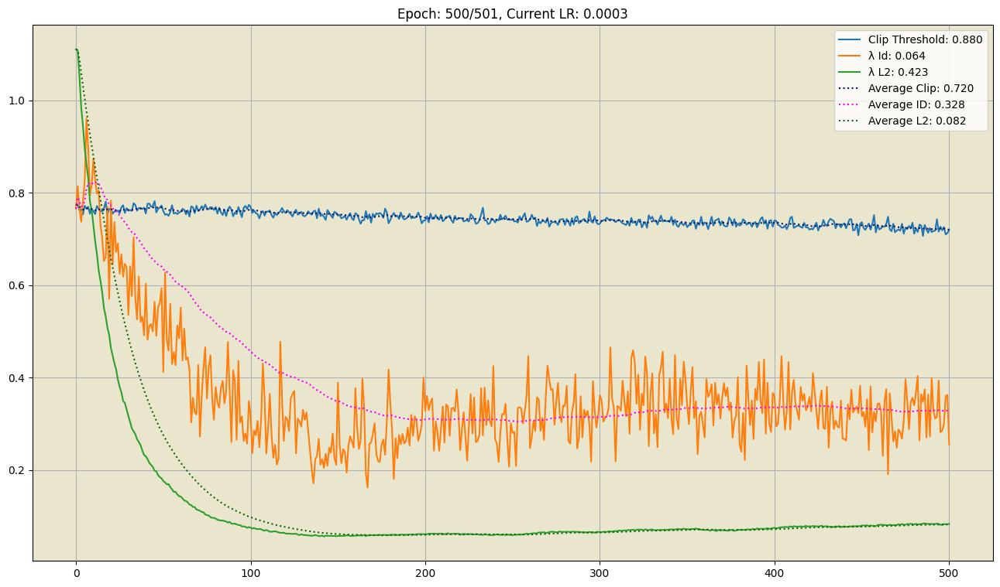

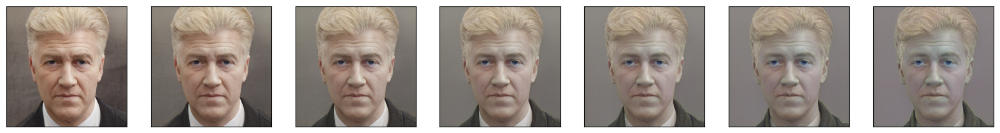

100%|██████████| 501/501 [04:41<00:00,  1.78it/s]


In [8]:
torch.manual_seed(5)
random.seed(5)
optimizer = LatentMapperOptimization(["Young Person"],net.decoder,inf_latents=latents)
optimizer.fit(501,lambda_id=2,lambda_l2=2,inference_interval = 20,l2_threshold = 0.05,id_threshold = 0.05,mode = 'balanced')

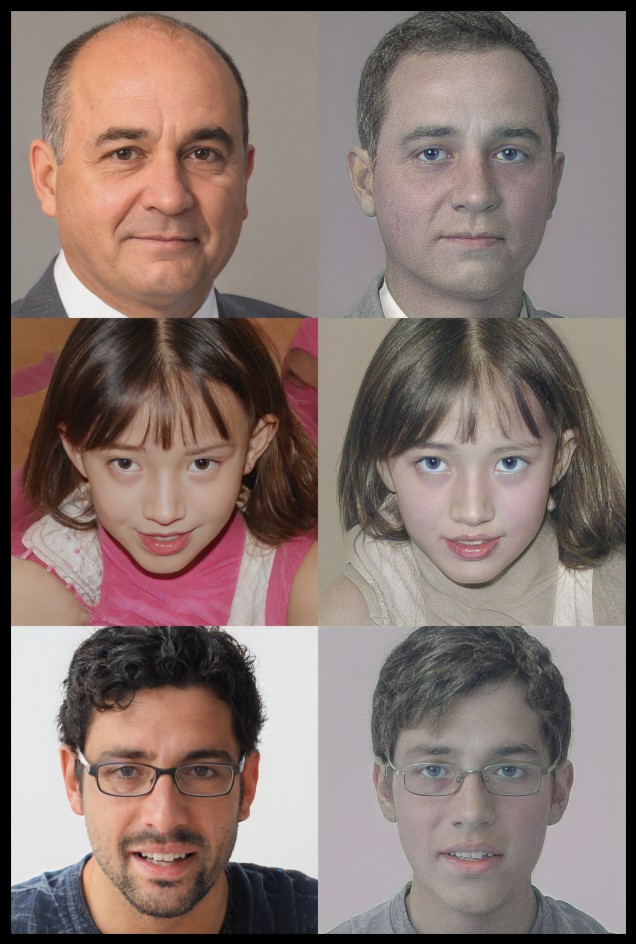

In [9]:
torch.manual_seed(2)
random.seed(2)

## Generate grid of randomly generated images
generate_grid(net.decoder,optimizer,3,2,1)

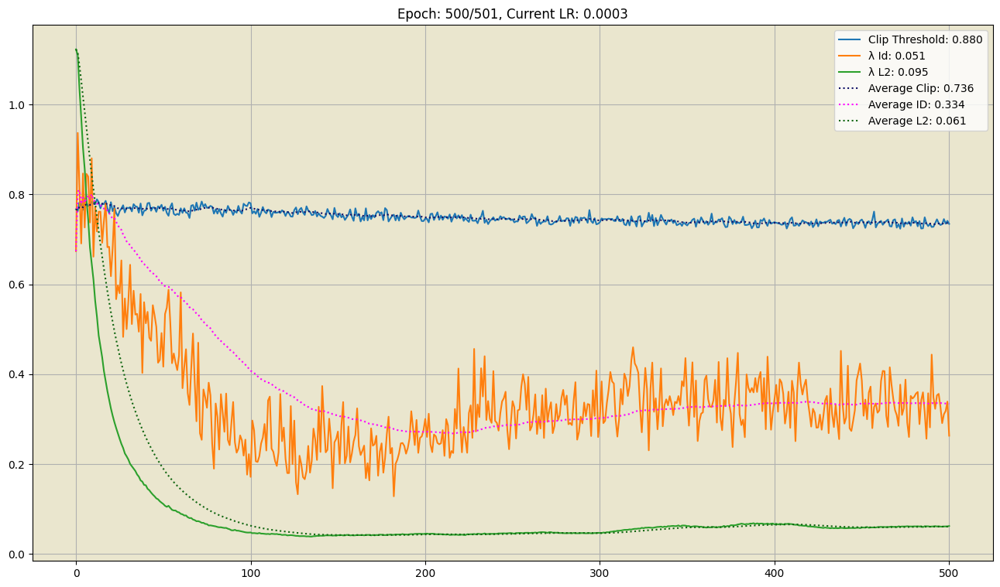

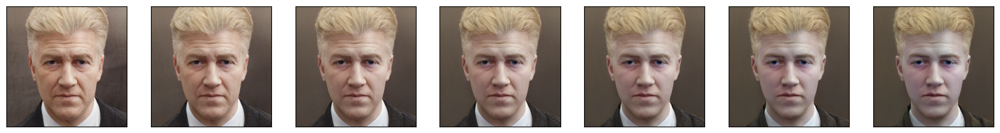

100%|██████████| 501/501 [04:41<00:00,  1.78it/s]


In [9]:
torch.manual_seed(5)
random.seed(5)

## Here we have 3 mapper blocks which are responsible for [:3], [3:8], [8:] latent vectors from W+ space
optimizer = LatentMapperOptimization(["Young person"],net.decoder,inf_latents=latents,levels = [3,8])
optimizer.fit(101,lambda_id=2,lambda_l2=2,inference_interval = 20,l2_threshold = 0.05,id_threshold = 0.05,mode = 'balanced')

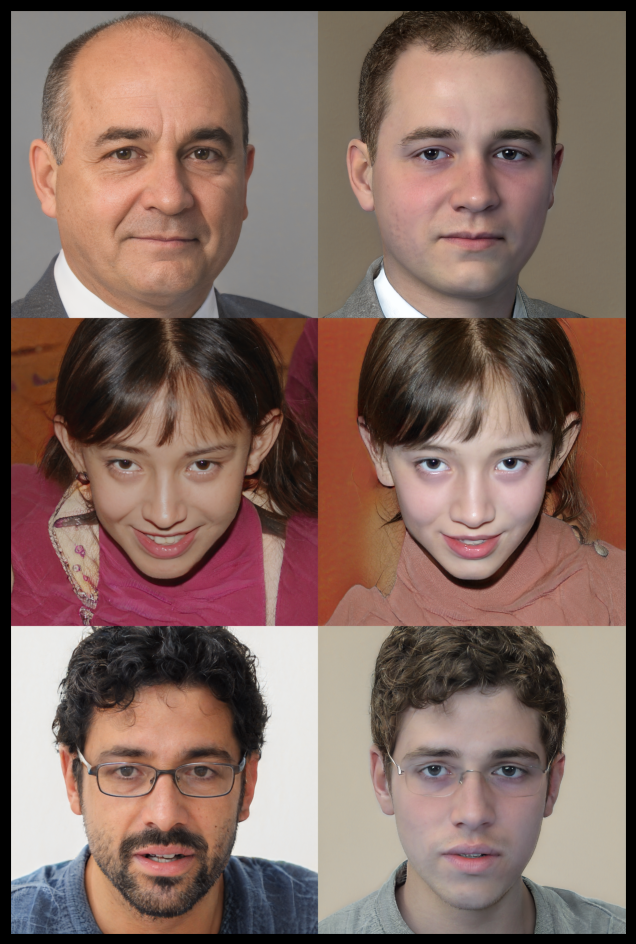

In [32]:
torch.manual_seed(2)
random.seed(3)
generate_grid(net.decoder,optimizer,3,2,1)

some mapper spaces could be interpreted in negative way

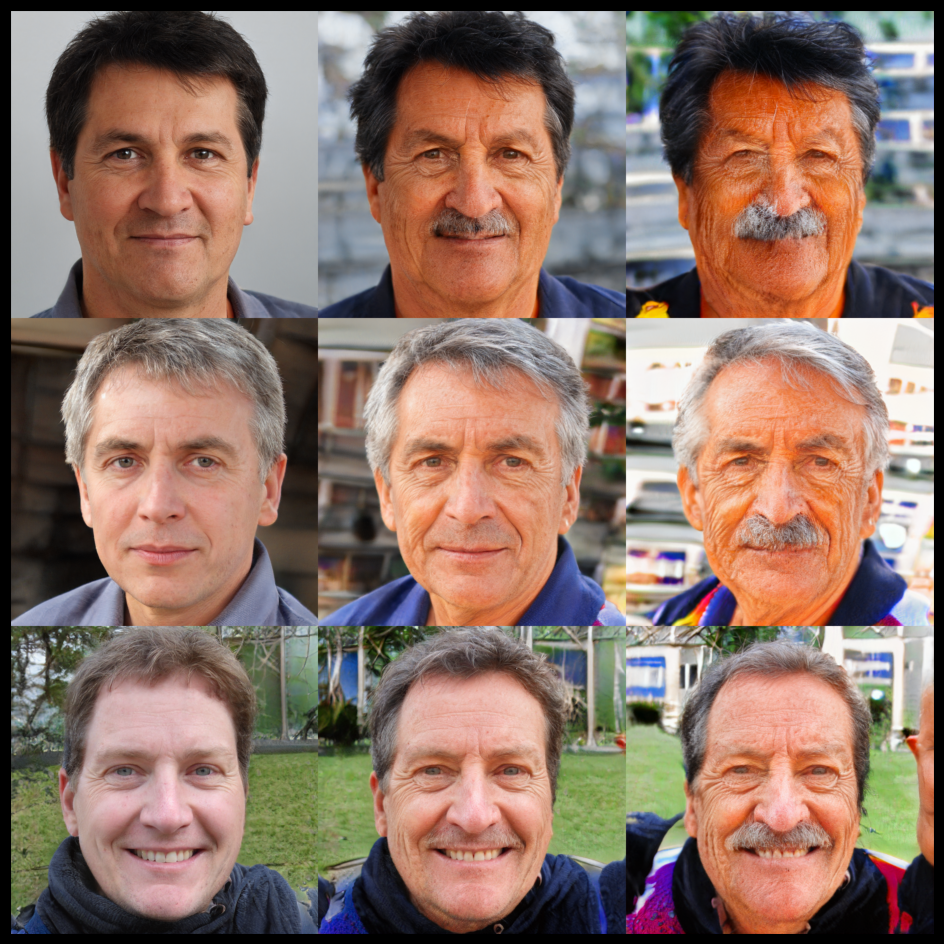

In [24]:
torch.manual_seed(3485)
random.seed(3)
generate_grid(net.decoder,optimizer,3,3,-0.7)